# VGI demo

Variational Gibbs inference (VGI) is a general-purpose method for statistical model estimation from incomplete data. The method starts by imputing the incomplete data with $K$ random imputations. And then it works by iteratively learning the statistical model $p_{\theta}(\mathbf{x})$ and variational approximation of the Gibbs conditionals $q_{\phi}(x_j \mid \mathbf{x}_{\text{obs}}, \mathbf{x}_{\text{mis}\smallsetminus j})$ under the target model $p_\theta$ for all missing dimensions $j$, and using the variational Gibbs conditionals to update the imputed values via a pseudo-Gibbs sampler. For more details, we invite the interested to read our paper _"Variational Gibbs inference for statistical model estimation from incomplete data"_.

In this notebook we illustrate the learning process of VGI by fitting two statistical models: a [full-rank Gaussian](#Full-rank-Gaussian-(simple%29) and a [mixture of Gaussians](#Mixture-of-Gaussians-(harder%29), both of which also admit fitting via the classical EM algorithm, which we also illustrate.

You should be able to view the animated learning process in your browser without running any of the following code:

* [Full-rank Gaussian animation](#Animation-(Gauss-with-VGI%29)
* [Mixture of Gaussians animation](#Animation-(MoG-with-VGI%29)

Note: GitHub does not load these animations, instead copy the URL to <https://nbviewer.org/> to view. Otherwise just run the following notebook on your machine to reproduce. To run this you will need to set up the environment as described in the readme of this repository.

In [1]:
# for auto-reloading external modules
%load_ext autoreload
%autoreload 2

In [2]:
import torch
import pytorch_lightning as pl
from pytorch_lightning.callbacks import Callback
from jsonargparse import ArgumentParser
import scipy
import scipy.stats
from tqdm import tqdm

import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from matplotlib.animation import ArtistAnimation
from IPython import display

%matplotlib inline
# %matplotlib notebook

from cdi.trainers.variational_cdi import VarCDI
from cdi.trainers.gauss_expectation_maximisation import GaussEM
from cdi.trainers.mog_expectation_maximisation import MoGEM
from cdi.layers.channel_linear import LinearWithChannels
from cdi.data.custom_dataset import CustomDataset

from cdi.util.arg_utils import dict_to_namespace
from cdi.util.arg_utils import parse_bool
from cdi.util.utils import set_random

In [3]:
# Make the notebook wider
display.display(display.HTML("<style>.container { width:70% !important; }</style>"))

## Prerequisite for animations

The visualisations use `ffmpeg` utility for creating animations of the learning process. You can install it from <https://www.ffmpeg.org/>, or if you're on a Debian-based linux distributions you might be able to install it with `sudo apt install ffmpeg`.

In [4]:
# If you install it manually, you will have to uncomment the following line and replace the path below with path your installation.
# plt.rcParams['animation.ffmpeg_path'] = '/path_to_your/ffmpeg'

## Helpers

Here we implement some helper code, which helps us track the models throughout training and animate the progress. Feel free to skip reading this section.

In [5]:
def create_grid(min_v, max_v, bins=100):
    """Creates the grid for visualising 2D marginal densities"""
    x0, x1 = np.mgrid[min_v:max_v*1.01:(max_v-min_v)/bins, 
                      min_v:max_v*1.01:(max_v-min_v)/bins]
    pos = np.empty(x0.shape + (2,))
    pos[:, :, 0] = x0
    pos[:, :, 1] = x1
    return x0, x1, torch.tensor(pos).float()

In [6]:
def plot_pairwise_marginal_contourfs(fig, grid_spec, dims, limits, params, distribution_type, *, log_domain=False):
    """Used for plotting pairwise 2D marginals as filled contour plots"""
    min_v, max_v = limits
    
    if distribution_type == 'mog':
        marginal_log_prob = marginal_log_prob_mog
    elif distribution_type == 'gauss':
        marginal_log_prob = marginal_log_prob_gauss
    
    for i in range(0, dims):
        for j in range(i+1, dims):
            # Plot pairs of dimensions
            ax = fig.add_subplot(grid_spec[i, j-1])

            x0, x1, pos = create_grid(min_v, max_v)

            log_pdf = marginal_log_prob(pos, params, dims=[i, j])
            pdf = torch.exp(log_pdf)

            contour = ax.contourf(x0, x1, log_pdf if log_domain else pdf, levels=10)

            ax.tick_params(left=False, labelleft=False,
                           bottom=False, labelbottom=False)

            # Set common limits
            ax.set_ylim(min_v, max_v)
            ax.set_xlim(min_v, max_v)

            if i == 0:
                ax.set_title(f'dim={j}', fontsize=12)
            if j == 1:
                ax.set_ylabel(f'dim={i}', fontsize=12)

        # Create dummy axes to add labels on the left-hand side
        if 0 < i < (dims-1):
            ax = fig.add_subplot(dims-1, dims-1, i*(dims-1)+1)
            ax.set_ylabel(f'dim={i}', fontsize=12)
            # Hide the dummy axes
            ax.xaxis.set_visible(False)
            plt.setp(ax.spines.values(), visible=False)
            ax.tick_params(left=False, labelleft=False)
            ax.patch.set_visible(False)

    grid_spec.tight_layout(fig)

In [7]:
def create_animation_frame(fig, gs_left, gs_right, limits, truth_params, snap, X_refs, distribution_type, *, 
                           pairwise_log_domain=False, cond_log_domain=False,
                           plot_conditionals=True,
                           plot_var_conditionals=False, plot_imputations=False,
                           show_conditioning_set_log_prob=False):
    """Generates a single frame which visualises the state of the algorithm at a particular iteration"""
    min_v, max_v = limits

    model_params = snap['model']
    # Visualise only 100 data-points
    data = snap['data']['X'][:100]
    dims = data.shape[-1]
    epoch = snap['epoch']
    
    if plot_var_conditionals:
        var_params = snap['var']
    
    # Use corresponding functions for different distribution types
    if distribution_type == 'mog':
        marginal_log_prob = marginal_log_prob_mog
        univariate_conditional_log_prob = univariate_conditional_log_prob_mog
        var_univariate_log_prob = var_univariate_log_prob_mog
        compute_kl_div = compute_kl_div_mog
    elif distribution_type == 'gauss':
        marginal_log_prob = marginal_log_prob_gauss
        univariate_conditional_log_prob = univariate_conditional_log_prob_gauss
        var_univariate_log_prob = var_univariate_log_prob_gauss
        compute_kl_div = compute_kl_div_gauss
    
    # Store all mpl artists for this frame in a list
    artists = []
    
    # Compute the KL divergence between the true distribution and the model
    kl_div = compute_kl_div(truth_params, model_params)
    text = fig.text(0.5, 0.95, f'Epoch {epoch}, ' + r'$D_{\mathrm{KL}}(p_* || p_{\theta})=' + f'{kl_div:.3f}$', 
                    color='k', visible=True, size=16,
                    ha='center', va='bottom')
    artists.append(text)
    
    # Plot pairs of dimensions
    for i in range(0, dims):
        for j in range(i+1, dims):
            ax = fig.add_subplot(gs_left[i, j-1])
            artists.append(ax)
            
            x0, x1, pos = create_grid(min_v, max_v)

            # Plot truth contours
            
            log_pdf = marginal_log_prob(pos, truth_params, dims=[i, j])
            pdf = torch.exp(log_pdf)
            
            truth_cont = ax.contour(x0, x1, log_pdf if pairwise_log_domain else pdf, 
                                    levels=10, colors='#000000')
            levels = truth_cont.levels
            
            # Plot the model contours using the same levels from the truth plot

            log_pdf = marginal_log_prob(pos, model_params, dims=[i, j])
            pdf = torch.exp(log_pdf)

            ax.contour(x0, x1, log_pdf if pairwise_log_domain else pdf, 
                       levels=levels, colors='#348ABD')

            if plot_imputations:
                # Plot data scatter
                ax.scatter(data[:, i], data[:, j], marker='.',
                           alpha=0.7, color='#E24A33', label='Imputations')

            ax.tick_params(left=False, labelleft=False,
                           bottom=False, labelbottom=False)

            # Set common limits
            ax.set_ylim(min_v, max_v)
            ax.set_xlim(min_v, max_v)

            if i == 0:
                ax.set_title(f'dim={j}', fontsize=12)
            if j == 1:
                ax.set_ylabel(f'dim={i}', fontsize=12)

            # Add legend for the marginals plot
            if i == 0 and j == i+1:
                handles, labels = ax.get_legend_handles_labels()
                contour_handles = [mpl.lines.Line2D([], [], color='#000000'),
                                   mpl.lines.Line2D([], [], color='#348ABD'), ]
                contour_labels = ['True distribution',
                                  'Model distribution']
                handles = contour_handles + handles
                labels = contour_labels + labels
                legend = ax.legend(handles, labels,
                                   ncol=3,
                                   bbox_to_anchor=(
                                       (gs_left.left+gs_left.right)/2, 0.92),
                                   bbox_transform=fig.transFigure,
                                   loc='center',
                                   prop={'size': 12},
                                   frameon=False)
                artists.append(legend)

        # Create dummy axes to add labels on the left-hand side
        if 0 < i < (dims-1):
            ax = fig.add_subplot(gs_left[i, 0])
            artists.append(ax)

            ax.set_ylabel(f'dim={i}', fontsize=12)
            # Hide the dummy axes
            ax.xaxis.set_visible(False)
            plt.setp(ax.spines.values(), visible=False)
            ax.tick_params(left=False, labelleft=False)
            ax.patch.set_visible(False)

    if plot_conditionals:
        # Plot conditionals
        for i in range(0, dims):
            for j in range(X_refs.shape[0]):
                ax = fig.add_subplot(gs_right[i, j])
                artists.append(ax)

                Z = torch.linspace(min_v, max_v, 70, dtype=torch.float)

                # Plot true conditionals

                log_pdf = univariate_conditional_log_prob(Z, truth_params, i, X_refs[j])
                pdf = torch.exp(log_pdf)

                ax.plot(Z, log_pdf if cond_log_domain else pdf, 
                        label='True conditionals', color='#000000')

                # Plot model conditionals

                log_pdf = univariate_conditional_log_prob(Z, model_params, i, X_refs[j])
                pdf = torch.exp(log_pdf)

                ax.plot(Z, log_pdf if cond_log_domain else pdf, 
                        label='Model conditionals', color='#348ABD')

                if plot_var_conditionals:
                    # Plot variational conditionals 
                    log_pdf = var_univariate_log_prob(Z, var_params, i, j)
                    pdf = torch.exp(log_pdf)

                    ax.plot(Z, log_pdf if cond_log_domain else pdf, 
                            label='Variational conditionals', color='#E24A33')

                if j == 0:
                    ax.set_ylabel(f'dim={i}', fontsize=12)

                ax.tick_params(left=False, labelleft=False,
                               bottom=False, labelbottom=False)
                ax.spines['right'].set_visible(False)
                ax.spines['left'].set_visible(False)
                ax.spines['top'].set_visible(False)

                if i == 0 and j == 0:
                    legend = ax.legend(ncol=3,
                                       bbox_to_anchor=(
                                           (gs_right.left+gs_right.right)/2, 0.92),
                                       bbox_transform=fig.transFigure,
                                       loc='center',
                                       prop={'size': 12},
                                       frameon=False)
                    artists.append(legend)

                if show_conditioning_set_log_prob:
                    # Show the (log-)probability of the conditioning set
                    not_i = torch.ones(X_refs.shape[-1], dtype=torch.bool)
                    not_i[i] = 0
                    X_ref_noti = X_refs[j][not_i]

                    log_prob = marginal_log_prob(X_ref_noti, model_params, dims=not_i)
                    ax.set_xlabel(
                        '$\log p(x_{\smallsetminus j}$)='+f'{log_prob:.2f}', fontsize=12)
    
    return artists


In [8]:
class SnapshotCallback(Callback):
    """
    Used to snapshot learnt model parameters and the variational conditional 
    predictions at the provided reference points during training
    """
    def __init__(self, X_ref=None):
        super().__init__()
        self.snaps = []
        
        if X_ref is not None:
            if isinstance(X_ref, np.ndarray):
                X_ref = torch.tensor(X_ref)
            if len(X_ref.shape) == 1:
                # Create batch dimension
                X_ref = X_ref.unsqueeze(0)
        
        self.X_ref = X_ref
        
    def on_train_start(self, trainer, pl_module):
        data = pl_module.train_dataset[:]
        snap = {
            'epoch': -1,
            'train_loss': 0.,
            'data': {
                'X': data[0],
                'M': data[1],
                'I': data[2],
            },
            'model': {}
        }
        for key, param in pl_module.fa_model.get_param_dict().items():
            snap['model'][key] = param.detach().cpu().clone()
        
        # Compute reference conditionals
        if self.X_ref is not None and hasattr(pl_module, 'variational_model'):
            ref_conditionals_snap = self.ref_variational_conditionals(pl_module)
            snap['var'] = ref_conditionals_snap
        
        self.snaps.append(snap)

    def on_epoch_end(self, trainer, pl_module):
        data = pl_module.train_dataset[:]
        snap = {
            'epoch': pl_module.current_epoch,
            'train_loss': trainer.callback_metrics["train_loss"],
            'data': {
                'X': data[0],
                'M': data[1],
                'I': data[2],
            },
            'model': {}
        }
        for key, param in pl_module.fa_model.get_param_dict().items():
            snap['model'][key] = param.detach().cpu().clone()
        
        # Compute reference conditionals
        if self.X_ref is not None and hasattr(pl_module, 'variational_model'):
            ref_conditionals_snap = self.ref_variational_conditionals(pl_module)
            snap['var'] = ref_conditionals_snap
        
        self.snaps.append(snap)

    def ref_variational_conditionals(self, pl_module):
        X_ref = self.X_ref.to(pl_module.variational_model.device)
        params_dict = pl_module.variational_model.named_forward(X_ref, M=None)
        snap = {
            key: param.detach().cpu()
            for key, param in params_dict.items()
        }

        return snap

# Full-rank Gaussian (simple)

We start our demonstration with the simplest model - a full-rank Gaussian. Due to its simplicity we expect both the EM and VGI perform very well on this task.

## Gaussian utilities

Some utilities we use for visualisations. Feel free to skip.

In [9]:
def marginal_log_prob_gauss(X, params, dims):
    """Marginal log-probability of the chosen dimensions evaluated at X"""
    mean = params['mean'][dims]
    cov = params['cov'][dims, :][:, dims]
    
    gauss = create_mv_gauss(mean, cov=cov)
    
    return gauss.log_prob(X)

def univariate_conditional_log_prob_gauss(z, model_params, dim, x_cond):
    """Computes the conditional distribution of the given joint model and then evaluates at z"""
    mean = model_params['mean']
    cov = model_params['cov']
    
    # Compute the conditional parameters
    var_i = cov[dim, dim]
    not_i = torch.ones(x_cond.shape[0], dtype=torch.bool)
    not_i[dim] = 0
    cov_inoti = cov[not_i, dim]
    cov_noti = cov[not_i, :][:, not_i]

    mu_i = mean[dim] + cov_inoti[None, :] @ torch.inverse(cov_noti) @ (x_cond[not_i] - mean[not_i])
    std_i = (var_i - cov_inoti[None, :] @ torch.inverse(cov_noti) @ cov_inoti)**(1/2)
    
    gauss = torch.distributions.Normal(loc=mu_i, scale=std_i)
    return gauss.log_prob(z)

def var_univariate_log_prob_gauss(z, var_params, dim, cond_idx):
    var_means = var_params['means'][cond_idx, dim]
    var_stds = torch.exp(0.5*var_params['log_vars'][cond_idx, dim])
    
    gauss = torch.distributions.Normal(loc=var_means, scale=var_stds)
    
    return gauss.log_prob(z)

def compute_kl_div_gauss(params1, params2):
    """Computes the KL divergence between two Gaussians"""
    mean1 = params1['mean']
    cov1 = params1['cov']
    mean2 = params2['mean']
    cov2 = params2['cov']
    slog_det1 = torch.slogdet(cov1)
    log_det1 = slog_det1[0] * slog_det1[1]
    slog_det2 = torch.slogdet(cov2)
    log_det2 = slog_det2[0] * slog_det2[1]

    dif = mean2 - mean1
    # Could be implemented more efficiently, but it works
    kl_div = (1/2) * (log_det2 - log_det1
                      - mean1.shape[0] + torch.trace(torch.inverse(cov2) @ cov1)
                      + dif.T @ torch.inverse(cov2) @ dif)
    return kl_div

## Generate data

Generate some random Gaussian distribution and sample training data from it. You can change the random seeds to generate different Gaussian distributions.

In [10]:
def generate_gauss(dims, standardise=False):
    """Generates a random Gaussian distribution"""
    cov_truth = scipy.stats.invwishart.rvs(df=dims, scale=np.eye(dims), size=1)
    mean_truth = np.random.randn(dims)
    
    if standardise:
        # Get standard deviation of marginals
        std = np.diagonal(cov_truth)**(0.5)

        # Standardise the covariance matrix
        L = (np.linalg.cholesky(cov_truth)/std[:, None])
        cov_truth = L @ L.T

        # Standardise the means
        mean_truth = np.zeros(dims)
    
    return {'mean': torch.tensor(mean_truth).float(),
            'cov': torch.tensor(cov_truth).float()}
    
def create_mv_gauss(mean, *, cov=None, scale_tril=None):
    gauss = torch.distributions.MultivariateNormal(
        loc=mean, covariance_matrix=cov, scale_tril=scale_tril)
    return gauss
    
def sample_gauss(num_samples, mean, *, cov=None, scale_tril=None):
    """Sample a Gaussian distribution"""
    gauss = create_mv_gauss(mean, cov=cov, scale_tril=scale_tril)

    return gauss.sample(sample_shape=(num_samples,)).to(torch.float)

In [11]:
np.random.seed(20211023)
torch.manual_seed(20211023)

dims = 5
num_samples = 4000

# Generate a random ground truth distribution and sample it
gauss_params_truth = generate_gauss(dims, standardise=False)
gauss_train_data = sample_gauss(num_samples, **gauss_params_truth)

We visualise the 5-dimensional Gaussian distribution using 2-dimensional pairwise marginals.

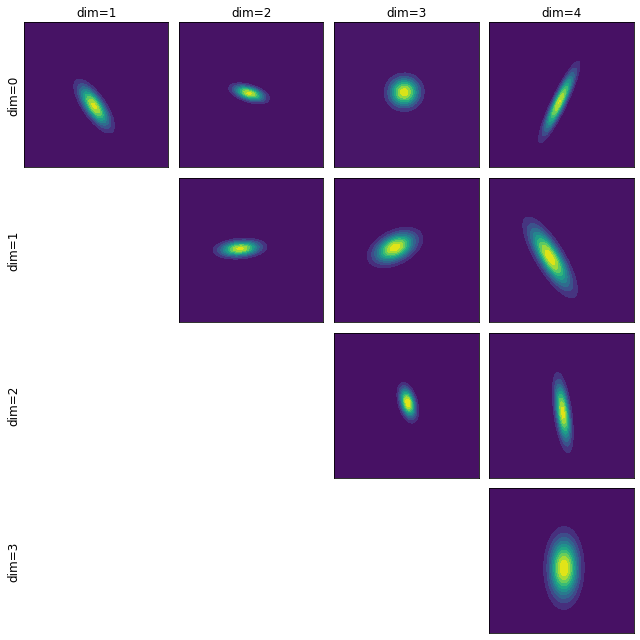

In [12]:
dims = gauss_train_data.shape[-1]

fig = plt.figure(figsize=(9,9))
gs = gridspec.GridSpec(ncols=dims-1, nrows=dims-1, figure=fig)

max_v = gauss_train_data.max().numpy()
min_v = gauss_train_data.min().numpy()

plot_pairwise_marginal_contourfs(fig, gs, dims, (min_v, max_v), gauss_params_truth, distribution_type='gauss')

## Models

We now define the two main models: the Gaussian model, which is the target statistical model we want to learn. And the variational model, which approximates the Gibbs conditionals of the statistical model.

In [13]:
class GaussianModel(pl.LightningModule):
    def __init__(self, hparams):
        super().__init__()
        self.hparams = hparams.gauss_model

        self.mean = torch.nn.Parameter(torch.zeros(self.hparams.dim))

        # Use Cov = LL^T decomposition
        num_params = ((self.hparams.dim - 1) * self.hparams.dim) // 2
        self.scale_tril_entries = torch.nn.Parameter(torch.zeros(num_params))
        self.unconstrained_diag = torch.nn.Parameter(
            torch.zeros(self.hparams.dim))

        self.register_buffer("tril_indices",
                             torch.tril_indices(
                                 self.hparams.dim, self.hparams.dim, offset=-1),
                             persistent=False)
        self.register_buffer("diag_indices",
                             torch.arange(self.hparams.dim),
                             persistent=False)

        self.reset_parameters()

    @staticmethod
    def add_model_args(parser):
        parser.add_argument('--gauss_model.dim', type=int,
                            help='Data dimensionality.')
        parser.add_argument('--gauss_model.random_init', type=parse_bool,
                            default=False,
                            help='Initialise the model randomly.')
        return parser

    @property
    def scale_tril_diag(self):
        # Make diagonal entries positive
        return torch.exp(self.unconstrained_diag)

    @property
    def scale_tril(self):
        # Create the lower-triangular matrix with positive diagonal
        scale_tril = self.scale_tril_entries.new_zeros(
            self.hparams.dim, self.hparams.dim)
        scale_tril[self.tril_indices[0],
                   self.tril_indices[1]] = self.scale_tril_entries
        scale_tril[self.diag_indices, self.diag_indices] = self.scale_tril_diag
        return scale_tril

    @property
    def cov(self):
        L = self.scale_tril
        return L @ L.T

    def get_param_dict(self):
        return {'mean': self.mean.detach().cpu(),
                'cov': self.cov.detach().cpu()}
    
    def forward(self, X, M):
        return self.log_prob(X)

    def log_prob(self, X):
        multi_norm = create_mv_gauss(self.mean, scale_tril=self.scale_tril)

        # Compute the log-probability of samples in X
        return multi_norm.log_prob(X)

    def reset_parameters(self):
        if self.hparams.random_init:
            stdv = 1.0 / self.hparams.dim**0.5
            torch.nn.init.uniform_(self.mean, -stdv, stdv)
            torch.nn.init.uniform_(self.scale_tril_entries, -stdv, stdv)
            torch.nn.init.uniform_(self.unconstrained_diag, -stdv, stdv)
        else:
            # Inits to standard Gaussian
            torch.nn.init.zeros_(self.mean)
            torch.nn.init.zeros_(self.scale_tril_entries)
            torch.nn.init.zeros_(self.unconstrained_diag)

In [14]:
class GaussianVarConditionals(pl.LightningModule):
    def __init__(self, hparams):
        super().__init__()
        self.hparams = hparams.var_model

        self.init_nn()
        self.reset_parameters()

    def init_nn(self):
        # Add input dimension to the hidden layer dim list
        layer_dims = [self.hparams.input_dim] + self.hparams.hidden_dims

        # Create network layers
        mean_layers = []
        log_var_layers = []
        for i in range(len(layer_dims)-1):
            mask = None
            if i == 0:
                # In the first layer of the j-th conditional, mask the
                # j-th input with a zero.
                # Prepare input weight mask, zeros on diag, elsewhere 1
                mask = (torch.ones(self.hparams.input_dim, self.hparams.input_dim)
                        - torch.eye(self.hparams.input_dim, self.hparams.input_dim))
                mask = mask.unsqueeze(-2)

            # Using a custom LinearWithChannels layer, which is analogous to Linear.
            # Allows parallel computation of all d conditionals for each input:
            # each "channel" corresponds to different conditional.
            mean_layers.append(LinearWithChannels(in_features=layer_dims[i],
                                                  out_features=layer_dims[i+1],
                                                  channels=self.hparams.input_dim,  # d conditionals
                                                  mask=mask,
                                                  reduce_mem=False))
            log_var_layers.append(LinearWithChannels(in_features=layer_dims[i],
                                                     out_features=layer_dims[i+1],
                                                     channels=self.hparams.input_dim,  # d conditionals
                                                     mask=mask,
                                                     reduce_mem=False))

            mean_layers.append(torch.nn.LeakyReLU())
            log_var_layers.append(torch.nn.LeakyReLU())

        # Add final output layers
        mean_layers.append(LinearWithChannels(in_features=layer_dims[-1],
                                              out_features=1,  # one output for each conditional
                                              channels=self.hparams.input_dim,  # d conditionals
                                              reduce_mem=False))
        log_var_layers.append(LinearWithChannels(in_features=layer_dims[-1],
                                                 out_features=1,  # one output for each conditional
                                                 channels=self.hparams.input_dim,  # d conditionals
                                                 reduce_mem=False))

        self.mean = torch.nn.Sequential(*mean_layers)
        self.log_var = torch.nn.Sequential(*log_var_layers)

    @staticmethod
    def add_model_args(parser):
        parser.add_argument('--var_model.input_dim',
                            type=int, required=True,
                            help='Dimensionality of input.')
        parser.add_argument('--var_model.hidden_dims',
                            type=int, nargs='+', required=True,
                            help=('Dimensionalities of layers.'))
        return parser

    # The rest of the args are not used, but are there for backwards compatibility
    def forward(self, X, M=None, *args, **kwargs):
        """Returns the conditional Gaussian parameters for all Gibbs conditionals"""
        means = self.mean(X.unsqueeze(1)).squeeze(2)
        log_vars = self.log_var(X.unsqueeze(1)).squeeze(2)

        return means, log_vars
    
    def named_forward(self, X, M=None):
        means, log_vars = self(X, M)
        
        return {
            'means': means.detach().cpu(),
            'log_vars': log_vars.detach().cpu()
        }

    def reset_parameters(self):
        for nn in [self.mean, self.log_var]:
            for layer in nn:
                if not isinstance(layer, (torch.nn.LeakyReLU, torch.nn.Sigmoid, torch.nn.ReLU)):
                    layer.reset_parameters()

## Learn with EM

We will make 50% of the data missing completely at random (MCAR). Then, we fit the model using the EM algorithm to have a reference of a "good" fit. 

In [15]:
class NotebookGaussEM(GaussEM):
    @staticmethod
    def load_dataset(hparams, stage, path=None):
        # Override load_dataset to provide a custom dataset from the notebook.
        return CustomDataset(gauss_train_data)

use_gpu = False
gpus = 0
max_epochs = 50

args = {
    'model_seed': 20211026,
    'data_seeds': [202111, 202122, 202133],
    'data': {
        'num_imputed_copies': 1,
        'total_miss': 0.5,
        'miss_type': 'MCAR',
        'pre_imputation': 'empirical_distribution_samples',
        'filter_fully_missing': True,
        # In EM, the batch-size must be >= the dataset size.
        'batch_size': 99999,
    },
    'gauss_model': {
        'dim': dims,
        'random_init': False,
    },
    'max_epochs': max_epochs
}
args = dict_to_namespace(args)

gauss = GaussianModel(args)

set_random(args.model_seed)
gauss.reset_parameters()

model = NotebookGaussEM(args,
                        model=gauss)


if torch.cuda.is_available() and use_gpu:
    gpus = torch.cuda.device_count()


gauss_em_snapshotCb = SnapshotCallback()

# Prepare trainer
trainer = pl.Trainer(gpus=gpus,
                     max_epochs=max_epochs,
                     callbacks = [gauss_em_snapshotCb])

# Train
trainer.fit(model)

# Clear output so that nbviewer does not render a large white space
# display.clear_output(wait=False)

### Animation (Gauss with EM)

Now that the model has been fit, we create the matplotlib animation that visualises the changes in the model throughout the iterations.

In [16]:
dims = gauss_train_data.shape[-1]
max_v = gauss_train_data.max().numpy().item()
min_v = gauss_train_data.min().numpy().item()

# X_refs = gauss_em_snapshotCb.X_ref
# choices = [3399, 717, 801, 1940, 1947, 1527, 1433]
choices = [717, 1940, 1947, 1527, 1433]
X_refs = gauss_train_data[choices]

fig = plt.figure(figsize=(16.2, 8.1))
gs_left = gridspec.GridSpec(ncols=dims-1, nrows=dims-1, figure=fig)
gs_left.update(left=0.02, right=0.40, wspace=0.05, hspace=0.05)
gs_right = gridspec.GridSpec(ncols=X_refs.shape[0], nrows=dims, figure=fig)
gs_right.update(left=0.44, right=0.98, wspace=0.05)#, hspace=0.05)

frames = []
for frame in tqdm(range(0, 41)):
    snap = gauss_em_snapshotCb.snaps[frame]

    artists = create_animation_frame(fig, gs_left, gs_right, (min_v, max_v), 
                                     gauss_params_truth, snap, X_refs, distribution_type='gauss')
    frames.append(artists)
    
anim = ArtistAnimation(fig, frames)

# Prevent an additional static figure
plt.close()

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 41/41 [00:26<00:00,  1.57it/s]


The following cell creates and displays the animation.

The left-hand side shows the 2D pairwise marginal distribution contours of the true distribution in black and the contours of the model distribution in blue.
On the right we also show the conditional pdfs using the true distribution and the conditionals under the model. Each row $j$ represents the conditional for the $j$-th dimension, and each column is evaluated at a different location.

The model starts as a standard Gaussian distribution, and as expected, the EM fits the model to the data very well and obtains a KL divergence of 0.01. The model conditionals are also good approximations of the true conditionals.

In [17]:
video = anim.to_jshtml()
# Alternative, but low-resolution
# video = anim.to_html5_video()
html = display.HTML(video)
display.display(html)

## Learn with VGI

Now, we also fit the Gaussian model using the VGI algorithm. As before, the data is missing 50% of the values. 

In [18]:
class NotebookVGI(VarCDI):
    @staticmethod
    def load_dataset(hparams, stage, path=None):
        # Override load_dataset to provide a custom dataset from the notebook.
        return CustomDataset(gauss_train_data)


use_gpu = False
max_epochs = 200

args = {
    'model_seed': 20211026,
    'data_seeds': [202111, 202122, 202133],
    'data': {
        # We use 5 imputations for each data-point
        'num_imputed_copies': 5,
        'total_miss': 0.5,
        'miss_type': 'MCAR',
        # The initial imputations are samples from the empirical marginals
        'pre_imputation': 'empirical_distribution_samples',
        'filter_fully_missing': True,
        'batch_size': 2048,
    },
    'gauss_model': {
        'dim': dims,
        'random_init': False,
    },
    'var_model': {
        'input_dim': dims,
        # Each variational conditional is learnt by a neural network with 2 hidden layers of 3 units
        'hidden_dims': [3, 3]
    },
    'cdi': {
        'update_components': 'MISSING',
        # A manual schedule for when the variational distribution should be updated
        # We skip the first iteration, for stability
        'update_comp_schedule': [0, 1],
        # -1 simply means that we sample 1 of the missing dimensions at random using the uniform Gibbs selection distribution
        'update_comp_schedule_values': [0, -1],
        'num_samples': 1,
        'entropy_coeff': 1.0,
        'sample_imputation': True,
        'imp_acceptance_check_schedule': [0],
        'imp_acceptance_check_schedule_values': [False],
        # We do not impute for the first 3 iterations to prevent divergent chains
        'imputation_delay': 3,
        # During Gibbs sampling we perform 5 steps at each iteration
        'num_imp_steps_schedule': [0],
        'num_imp_steps_schedule_values': [5],
        'imputation_comp_schedule': [0],
        'imputation_comp_schedule_values': [-1]
    },
    'model_optim': {
        'optimiser': 'adam',
        'learning_rate': 1e-1,
        'weight_decay_coeff': 0.0,
        'anneal_learning_rate': True,
    },
    'var_optim': {
        'optimiser': 'amsgrad',
        'learning_rate': 1e-1,
        'epsilon': 1e-8,
        'weight_decay_coeff': 0.0,
        'anneal_learning_rate': True,
    },
    'max_epochs': max_epochs
}
args = dict_to_namespace(args)

gauss = GaussianModel(args)
var_gauss = GaussianVarConditionals(args)

set_random(args.model_seed)
gauss.reset_parameters()
var_gauss.reset_parameters()

model = NotebookVGI(args,
                    model=gauss,
                    var_model=var_gauss)

gpus = 0
if torch.cuda.is_available() and use_gpu:
    gpus = torch.cuda.device_count()

# Reference points to log variational conditionals at
# choices = [3399, 717, 801, 1940, 1947, 1527, 1433]
choices = [717, 1940, 1947, 1527, 1433]
X_refs = gauss_train_data[choices]

gauss_vgi_snapshotCb = SnapshotCallback(X_ref=X_refs)

# Prepare trainer
trainer = pl.Trainer(gpus=gpus,
                     max_epochs=max_epochs,
                     callbacks=[gauss_vgi_snapshotCb])

# Train
trainer.fit(model)

# Clear output so that nbviewer does not render a large white space
# display.clear_output(wait=False)

### Animation (Gauss with VGI)

Now that the model has been fit, we create the matplotlib animation that visualises the changes in the model throughout the iterations.

In [19]:
dims = gauss_train_data.shape[-1]
max_v = gauss_train_data.max().numpy().item()
min_v = gauss_train_data.min().numpy().item()

X_refs = gauss_vgi_snapshotCb.X_ref
# choices = [3399, 717, 801, 1940, 1947, 1527, 1433]
# X_refs = gauss_train_data[choices]

fig = plt.figure(figsize=(16.2, 8.1))
gs_left = gridspec.GridSpec(ncols=dims-1, nrows=dims-1, figure=fig)
gs_left.update(left=0.02, right=0.40, wspace=0.05, hspace=0.05)
gs_right = gridspec.GridSpec(ncols=X_refs.shape[0], nrows=dims, figure=fig)
gs_right.update(left=0.44, right=0.98, wspace=0.05)#, hspace=0.05)

frames = []
for frame in tqdm(range(0, 200, 4)):
    snap = gauss_vgi_snapshotCb.snaps[frame]

    artists = create_animation_frame(fig, gs_left, gs_right, (min_v, max_v), 
                                     gauss_params_truth, snap, X_refs, distribution_type='gauss',
                                     plot_var_conditionals=True, plot_imputations=True)
    frames.append(artists)
    
anim = ArtistAnimation(fig, frames)

# Prevent an additional static figure
plt.close()

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:39<00:00,  1.25it/s]


The following cell creates and displays the animation.

The left-hand side shows the pairwise 2D marginal distribution contours of the true distribution in black and the contours of the model distribution in blue, as well as the imputed data-points in red.
On the right we show the conditional pdfs using the true distribution, the conditionals under the model, as well as the variational approximations. Each row $j$ represents the conditional for the $j$-th dimension, and each column is evaluated at a different location.

At every iteration the variational conditionals (red) are fitted to approximate the conditional distributions under the target statistical model (blue). The conditionals are then used to update the imputations (red scatter markers). The model (blue) is then fitted on these imputed data-points. The steps alternate until the model fits the data.

Given that the model is simple and well-specified, the model was fitted very well, and the variational conditionals also approximate the conditionals under the model accurately. Note also, that the imputations, which at first do not sample the true marginals, eventually converge to the true distribution.

In [20]:
video = anim.to_jshtml()
# Alternative, but low-resolution
# video = anim.to_html5_video()  
html = display.HTML(video)
display.display(html)

If you want to inspect the logs during training, such as the training loss, uncomment and run the following cell.

In [21]:
# %load_ext tensorboard
# %tensorboard --logdir lightning_logs/

# Mixture of Gaussians (harder)

Now that we have demonstrated VGI on a simple Gaussian, we also demonstrate it on a mixture of Gaussians (MoG). The optimisation landscape for MoGs includes multiple local optima even when the data is complete, hence the incomplete setting may be even more challenging.

## MoG utilities

In [22]:
def marginal_log_prob_mog(X, params, dims):
    """Marginal log-probability of the chosen dimensions evaluated at X"""
    comp_logits = params['comp_logits']
    means = params['means'][:, dims]
    covs = params['covs'][:, dims, :][:, :, dims]
    
    mog = create_mv_mog(comp_logits, means, covs=covs)
    
    return mog.log_prob(X)

def univariate_conditional_log_prob_mog(z, model_params, dim, x_cond):
    """Computes the conditional distribution of the given joint model and then evaluates at z"""
    comp_logits = model_params['comp_logits']
    means = model_params['means']
    covs = model_params['covs']

    X = x_cond[None, :].repeat(z.shape[0], 1)
    X[:, dim] = z
    
    not_i = torch.ones(x_cond.shape[0], dtype=torch.bool)
    not_i[dim] = 0

    joint_logprob = marginal_log_prob_mog(X, model_params, dims=torch.ones(x_cond.shape[0], dtype=torch.bool))
    conditioning_set_logprob = marginal_log_prob_mog(X[:, not_i], model_params, dims=not_i)
    
    return joint_logprob - conditioning_set_logprob

def var_univariate_log_prob_mog(z, var_params, dim, cond_idx):
    comp_logits = var_params['comp_logits'][cond_idx, dim]
    means = var_params['means'][cond_idx, dim]
    scales = torch.exp(0.5*var_params['log_vars'][cond_idx, dim])
    
    mix = torch.distributions.Categorical(logits=comp_logits)
    norms = torch.distributions.Normal(loc=means, scale=scales)
    mog = torch.distributions.MixtureSameFamily(mix, norms)
    
    if isinstance(z, np.ndarray):
        z = torch.tensor(z)
    return mog.log_prob(z)

def compute_kl_div_mog(params1, params2, N=1000000):
    """Estimates the KL divergence between two mixtures of Gaussians"""
    comp_logits1 = params1['comp_logits']
    means1 = params1['means']
    covs1 = params1['covs']
    
    comp_logits2 = params2['comp_logits']
    means2 = params2['means']
    covs2 = params2['covs']
    
    if comp_logits2.dtype != comp_logits1.dtype:
        comp_logits2 = comp_logits2.to(comp_logits1.dtype)
        means2 = means2.to(means1.dtype)
        covs2 = covs2.to(covs1.dtype)
    
    mog1 = create_mv_mog(comp_logits1, means1, covs=covs1)
    mog2 = create_mv_mog(comp_logits2, means2, covs=covs2)
    
    X = mog1.sample((N,))
    log_p1 = mog1.log_prob(X)
    log_p2 = mog2.log_prob(X)
    
    return (log_p1 - log_p2).mean()

## Generate data

We first generate some random MoG distribution and sample a training dataset. Feel free to change the fixed random seed, or the number of components, to get different ground truth distributions, however, note that the following hyperparameter settings set below were chosen using the current seed setting.

In [23]:
np.random.seed(20211018)
torch.manual_seed(20211019)

def generate_mog(num_components, dims, standardise=False):
    # Generate component mixture
    comp_probs_truth = scipy.stats.dirichlet.rvs(
        np.ones(num_components), size=1)[0]
    comp_logits_truth = np.log(comp_probs_truth)

    # Generate Gaussians
    covs_truth = scipy.stats.invwishart.rvs(
        df=dims, scale=np.eye(dims), size=num_components)
    means_truth = np.random.randn(num_components, dims)*3

    if standardise:
        # Compute the mean of the MoG
        mean = (means_truth*comp_probs_truth[:, None]).sum(0)
        # Compute the covariance of the MoG
        dif = means_truth - mean
        cov = covs_truth + dif[..., None] @ dif[:, None, :]
        cov *= comp_probs_truth[:, None, None]
        cov = cov.sum(0)

        # Get standard deviation of marginals
        std = np.diagonal(cov)**(0.5)

        # Standardise the covariance matrices
        L = (np.linalg.cholesky(covs_truth)/std[None, :, None])
        covs_truth = L @ L.transpose((0, 2, 1))

        # Standardise the means
        means_truth = (means_truth-mean)/std

    return {'comp_logits': torch.tensor(comp_logits_truth),
            'means': torch.tensor(means_truth),
            'covs': torch.tensor(covs_truth)
           }


def create_mv_mog(comp_logits, means, *, covs=None, scale_trils=None):
    mix = torch.distributions.Categorical(logits=comp_logits)
    multi_norms = torch.distributions.MultivariateNormal(
        loc=means, covariance_matrix=covs, scale_tril=scale_trils)
    comp = torch.distributions.Independent(multi_norms, 0)
    mog = torch.distributions.MixtureSameFamily(mix, comp)

    return mog


def sample_mog(num_samples, comp_logits, means, *, covs=None, scale_trils=None):
    mog = create_mv_mog(comp_logits, means, covs=covs, scale_trils=scale_trils)

    return mog.sample(sample_shape=(num_samples,)).to(torch.float)


num_components = 4
dims = 5
num_samples = 4000

# Generate distribution and sample it
mog_params_truth = generate_mog(num_components, dims, standardise=True)
mog_train_data = sample_mog(num_samples, **mog_params_truth)

We visualise the 5-dimensional mixture of Gaussian distribution using 2-dimensional pairwise marginals. Notice that the distribution is now more complex and multi-modal and hence more difficult to fit than the simple Gaussian case.

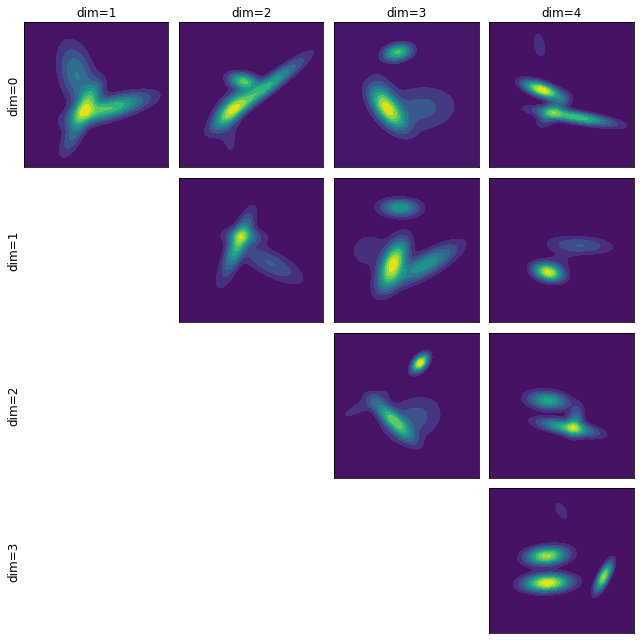

In [24]:
dims = mog_train_data.shape[-1]

max_v = mog_train_data.max().numpy()*0.7
min_v = mog_train_data.min().numpy()*0.7

fig = plt.figure(figsize=(9,9))
gs = gridspec.GridSpec(ncols=dims-1, nrows=dims-1, figure=fig)

plot_pairwise_marginal_contourfs(fig, gs, dims, (min_v, max_v), mog_params_truth, distribution_type='mog')

## Models

We now define the two main models: the mixture of Gaussians model, which is the target statistical model we want to learn. And the variational model, which approximates the Gibbs conditionals of the statistical model.

In [25]:
class MixtureOfGaussiansModel(pl.LightningModule):
    def __init__(self, hparams):
        super().__init__()
        self.hparams = hparams.mog_model
        
        self.comp_logits = torch.nn.Parameter(torch.zeros(self.hparams.num_components))

        self.means = torch.nn.Parameter(torch.zeros(
            self.hparams.num_components, self.hparams.dim))

        # Use Cov = LL^T decomposition
        num_params = ((self.hparams.dim - 1) * self.hparams.dim) // 2
        self.scale_tril_entries = torch.nn.Parameter(
            torch.zeros(self.hparams.num_components, num_params))
        self.unconstrained_diags = torch.nn.Parameter(
            torch.zeros(self.hparams.num_components, self.hparams.dim))

        self.register_buffer("tril_indices",
                             torch.tril_indices(
                                 self.hparams.dim, self.hparams.dim, offset=-1),
                             persistent=False)
        self.register_buffer("diag_indices",
                             torch.arange(self.hparams.dim),
                             persistent=False)

        self.reset_parameters()

    @staticmethod
    def add_model_args(parser):
        parser.add_argument('--mog_model.num_components', type=int,
                            help='Number of mixture components.')
        parser.add_argument('--mog_model.dim', type=int,
                            help='Data dimensionality.')
        parser.add_argument('--mog_model.random_init', type=parse_bool,
                            default=False,
                            help='Initialise the model randomly.')
        return parser

    @property
    def scale_tril_diags(self):
        # Make diagonal entries positive
        return torch.exp(self.unconstrained_diags)

    @property
    def scale_trils(self):
        # Create the lower-triangular matrix with positive diagonal
        scale_trils = self.scale_tril_entries.new_zeros(
            self.hparams.num_components, self.hparams.dim, self.hparams.dim)
        scale_trils[:, self.tril_indices[0],
                   self.tril_indices[1]] = self.scale_tril_entries
        scale_trils[:, self.diag_indices, self.diag_indices] = self.scale_tril_diags
        return scale_trils

    @property
    def covs(self):
        L = self.scale_trils
        return torch.bmm(L, L.transpose(-1, -2))

    def get_param_dict(self):
        return {'comp_logits': self.comp_logits.detach().cpu(),
                'means': self.means.detach().cpu(),
                'covs': self.covs.detach().cpu()}
    
    def forward(self, X, M):
        return self.log_prob(X)

    def log_prob(self, X):
        mix = torch.distributions.Categorical(logits=self.comp_logits)
        multi_norms = torch.distributions.MultivariateNormal(loc=self.means, scale_tril=self.scale_trils)
        comp = torch.distributions.Independent(multi_norms, 0)
        mog = torch.distributions.MixtureSameFamily(mix, comp)

        # Compute the log-probability of samples in X
        return mog.log_prob(X)

    def reset_parameters(self):
        if self.hparams.random_init:
            stdv = 1.0 / self.hparams.dim**0.5
#             torch.nn.init.uniform_(self.means, -stdv, stdv)
            torch.nn.init.uniform_(self.means, -3, 3)
            torch.nn.init.uniform_(self.scale_tril_entries, -stdv, stdv)
            torch.nn.init.uniform_(self.unconstrained_diags, -stdv, stdv)
#             torch.nn.init.uniform_(self.comp_logits, -2, 2)
            torch.nn.init.zeros_(self.comp_logits)
            
        else:
            # Inits to standard Gaussian but non-centered
#             torch.nn.init.zeros_(self.means)
            stdv = 1.0 / self.hparams.dim**0.5
            torch.nn.init.uniform_(self.means, -stdv, stdv)
            torch.nn.init.zeros_(self.scale_tril_entries)
            torch.nn.init.zeros_(self.unconstrained_diags)
            torch.nn.init.zeros_(self.comp_logits)

In [26]:
class MixtureOfGaussiansVarConditionals(pl.LightningModule):
    def __init__(self, hparams):
        super().__init__()
        self.hparams = hparams.var_model

        self.init_nn()
        self.reset_parameters()

    def init_nn(self):
        # Add input dimension to the hidden layer dim list
        layer_dims = [self.hparams.input_dim] + self.hparams.hidden_dims

        # Create network layers
        mean_layers = []
        log_var_layers = []
        comp_logit_layers = []
        for i in range(len(layer_dims)-1):
            mask = None
            if i == 0:
                # In the first layer of the j-th conditional, mask the
                # j-th input with a zero.
                # Prepare input weight mask, zeros on diag, elsewhere 1
                mask = (torch.ones(self.hparams.input_dim, self.hparams.input_dim)
                        - torch.eye(self.hparams.input_dim, self.hparams.input_dim))
                mask = mask.unsqueeze(-2)

            # Using a custom LinearWithChannels layer, which is analogous to Linear.
            # Allows parallel computation of all d conditionals for each input:
            # each "channel" corresponds to different conditional.
            mean_layers.append(LinearWithChannels(in_features=layer_dims[i],
                                                  out_features=layer_dims[i+1],
                                                  channels=self.hparams.input_dim,  # d conditionals
                                                  mask=mask,
                                                  reduce_mem=False))
            log_var_layers.append(LinearWithChannels(in_features=layer_dims[i],
                                                     out_features=layer_dims[i+1],
                                                     channels=self.hparams.input_dim,  # d conditionals
                                                     mask=mask,
                                                     reduce_mem=False))
            comp_logit_layers.append(LinearWithChannels(in_features=layer_dims[i],
                                                     out_features=layer_dims[i+1],
                                                     channels=self.hparams.input_dim,  # d conditionals
                                                     mask=mask,
                                                     reduce_mem=False))
            mean_layers.append(torch.nn.LeakyReLU())
            log_var_layers.append(torch.nn.LeakyReLU())
            comp_logit_layers.append(torch.nn.LeakyReLU())

        # Add final output layers
        mean_layers.append(LinearWithChannels(in_features=layer_dims[-1],
                                              out_features=self.hparams.num_components,  # one output for each conditional component
                                              channels=self.hparams.input_dim,  # d conditionals
                                              reduce_mem=False))
        log_var_layers.append(LinearWithChannels(in_features=layer_dims[-1],
                                                 out_features=self.hparams.num_components,  # one output for each conditional component
                                                 channels=self.hparams.input_dim,  # d conditionals
                                                 reduce_mem=False))
        comp_logit_layers.append(LinearWithChannels(in_features=layer_dims[-1],
                                                 out_features=self.hparams.num_components,  # one output for each conditional component
                                                 channels=self.hparams.input_dim,  # d conditionals
                                                 reduce_mem=False))

        self.mean = torch.nn.Sequential(*mean_layers)
        self.log_var = torch.nn.Sequential(*log_var_layers)
        self.comp_logits = torch.nn.Sequential(*comp_logit_layers)

    @staticmethod
    def add_model_args(parser):
        parser.add_argument('--var_model.num_components',
                            type=int, required=True,
                            help='Number of mixture components.')
        parser.add_argument('--var_model.input_dim',
                            type=int, required=True,
                            help='Dimensionality of input.')
        parser.add_argument('--var_model.hidden_dims',
                            type=int, nargs='+', required=True,
                            help=('Dimensionalities of layers.'))
        return parser

    # The rest of the args are not used, but are there for backwards compatibility
    def forward(self, X, M=None, *args, **kwargs):
        """Returns the conditional Gaussian parameters for all Gibbs conditionals"""
        means = self.mean(X.unsqueeze(1)).squeeze(2)
        log_vars = self.log_var(X.unsqueeze(1)).squeeze(2)
        comp_logits = self.comp_logits(X.unsqueeze(1)).squeeze(2)

        return means, log_vars, comp_logits

    def named_forward(self, X, M=None):
        means, log_vars, comp_logits = self(X, M)
        
        return {
            'means': means.detach().cpu(),
            'log_vars': log_vars.detach().cpu(),
            'comp_logits': comp_logits.detach().cpu(),
        }
    
    def reset_parameters(self):
        for nn in [self.mean, self.log_var, self.comp_logits]:
            for layer in nn:
                if not isinstance(layer, (torch.nn.LeakyReLU, torch.nn.Sigmoid, torch.nn.ReLU)):
                    layer.reset_parameters()

## Learn with EM

We will make 50% of the data missing completely at random (MCAR). Then, we fit the model using the EM algorithm to have a reference of a "good" fit. 

In [27]:
class NotebookMoGEM(MoGEM):
    @staticmethod
    def load_dataset(hparams, stage, path=None):
        # Override load_dataset to provide a custom dataset from the notebook.
        return CustomDataset(mog_train_data)

use_gpu = False
max_epochs = 150

args = {
    'model_seed': 20211029,
    'data_seeds': [202111, 202122, 202133],
    'data': {
        'num_imputed_copies': 1,
        'total_miss': 0.5,
        'miss_type': 'MCAR',
        # In EM, the batch-size must be >= the dataset size.
        'pre_imputation': 'empirical_distribution_samples',
        'filter_fully_missing': True,
        'batch_size': 99999,
    },
    'mog_model': {
        'num_components': 4,
        'dim': dims,
        'random_init': True,
    },
    'max_epochs': max_epochs
}
args = dict_to_namespace(args)

mog = MixtureOfGaussiansModel(args)

set_random(args.model_seed)
mog.reset_parameters()

model = NotebookMoGEM(args,
                      model=mog)

gpus = 0
if torch.cuda.is_available() and use_gpu:
    gpus = torch.cuda.device_count()

mog_em_snapshotCb = SnapshotCallback()

# Prepare trainer
trainer = pl.Trainer(gpus=gpus,
                     max_epochs=max_epochs,
                     callbacks = [mog_em_snapshotCb])

trainer.fit(model)

# Clear output so that nbviewer does not render a large white space
# display.clear_output(wait=False)

### Animation (MoG with EM)

Now that the model has been fit, we create the matplotlib animation that visualises the changes in the model throughout the iterations.

In [28]:
dims = mog_train_data.shape[-1]
max_v = mog_train_data.max().numpy().item()*0.7
min_v = mog_train_data.min().numpy().item()*0.7

# X_refs = mog_em_snapshotCb.X_ref
# choices = [3399, 717, 801, 1940, 1947, 1527, 1433]
choices = [717, 1940, 1947, 1527, 1433]
X_refs = mog_train_data[choices]

fig = plt.figure(figsize=(16.2, 8.1))
gs_left = gridspec.GridSpec(ncols=dims-1, nrows=dims-1, figure=fig)
gs_left.update(left=0.02, right=0.40, wspace=0.05, hspace=0.05)
gs_right = gridspec.GridSpec(ncols=X_refs.shape[0], nrows=dims, figure=fig)
gs_right.update(left=0.44, right=0.98, wspace=0.05)#, hspace=0.05)

frames = []
for frame in tqdm(range(0, 121, 3)):
    snap = mog_em_snapshotCb.snaps[frame]

    artists = create_animation_frame(fig, gs_left, gs_right, (min_v, max_v), 
                                     mog_params_truth, snap, X_refs, distribution_type='mog',
                                     show_conditioning_set_log_prob=True)
    frames.append(artists)
    
anim = ArtistAnimation(fig, frames)

# Prevent an additional static figure
plt.close()

  0%|                                                                                                                                                                  | 0/41 [00:00<?, ?it/s]/tmp/ipykernel_538390/4013576886.py:61: UserWarning: No contour levels were found within the data range.
  ax.contour(x0, x1, log_pdf if pairwise_log_domain else pdf,
100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 41/41 [01:22<00:00,  2.01s/it]


The following cell creates and displays the animation.

The left-hand side shows the 2D pairwise marginal distribution contours of the true distribution in black and the contours of the model distribution in blue.
On the right we also show the conditional pdfs using the true distribution and the conditionals under the model. Each row $j$ represents the conditional for the $j$-th dimension, and each column is evaluated at a different location.

In addition, under the plots on the right side we show the log-probability of the conditioning location under the statistical model. You should note that due to model misfit the conditionals are usually less accurate where the conditioning set has low probability.

As expected, MoG is more difficult to fit than the simple Gaussian. For example, the northern-most mode in the bottom-right marginal is underestimated, and the conditional distributions also show some disagreement. Moreover, with different initialisations (random seeds), the EM algorithm can sometimes get stuck in a very poor local optima. Nevertheless, with a good initialisation the EM achieves a good fit as shown below.

In [29]:
video = anim.to_jshtml()
# Alternative, but low-resolution
# video = anim.to_html5_video()
html = display.HTML(video)
display.display(html)

## Learn with VGI

Now, we also fit the mixture of Gaussians model using the VGI algorithm. As before, the data is missing 50% of the values. 

In [30]:
class NotebookVGI2(VarCDI):
    @staticmethod
    def load_dataset(hparams, stage, path=None):
        # Override load_dataset to provide a custom dataset from the notebook.
        return CustomDataset(mog_train_data)

use_gpu = False
gpus = 0
# max_epochs = 750
max_epochs = 1500

var_cfg = {
    # Each conditional is a 4-component MoG
    'num_components': 4,
    'input_dim': dims,
    # Each conditional uses a 2-hidden layer neural network with 15 units at each layer
    'hidden_dims': [15, 15]
}

data_cfg = {
    # We impute each incomplete data-point with 5 imputations
    'num_imputed_copies': 5,
    'total_miss': 0.5,
    'miss_type': 'MCAR',
    # The initial imputation distributions are the empirical marginals
    'pre_imputation': 'empirical_distribution_samples',
    'filter_fully_missing': True,
    'batch_size': 2048,
}

args = {
    'model_seed': 20211000,
    'data_seeds': [202111, 202122, 202133],
    'data': data_cfg,
    'mog_model': {
        'num_components': 4,
        'dim': dims,
        'random_init': True
    },
    'var_model': var_cfg,
    'cdi': {
        'conditional_type': 'mog',
        'update_components': 'MISSING',
        # A manual schedule for when the variational distribution should be updated
        # We skip the first iteration, for stability
        'update_comp_schedule': [0, 1],
        # The values accepted are between 0 and 1, and -1.
        # 1 means that for each incomplete data point we sample as many missing dimensions M as there are missing dimensions.
        'update_comp_schedule_values': [0, 1],
        'num_samples': 1,
        'entropy_coeff': 1.0,
        'sample_imputation': True,
        'imp_acceptance_check_schedule': [0],
        'imp_acceptance_check_schedule_values': [False],
        # We do not impute for the first 10 iterations to prevent divergent chains
        'imputation_delay': 10,
        'num_imp_steps_schedule': [0],
        # During Gibbs sampling we perform 3 steps at each iteration
        'num_imp_steps_schedule_values': [3],
        'imputation_comp_schedule': [0],
        'imputation_comp_schedule_values': [-1]
    },
    'model_optim': {
        'optimiser': 'adam',
#         'learning_rate': 3e-2,
        'learning_rate': 1e-2,
        'weight_decay_coeff': 0.0,
        'anneal_learning_rate': True,
    },
    'var_optim': {
        'optimiser': 'amsgrad',
#         'learning_rate': 3e-2,
        'learning_rate': 1e-2,
        'epsilon': 1e-8,
        'weight_decay_coeff': 0.0,
        'anneal_learning_rate': True,
    },
    'max_epochs': max_epochs
}
args = dict_to_namespace(args)

if torch.cuda.is_available() and use_gpu:
    gpus = torch.cuda.device_count()

var_mog = MixtureOfGaussiansVarConditionals(args)
mog = MixtureOfGaussiansModel(args)

set_random(args.model_seed)
mog.reset_parameters()
var_mog.reset_parameters()

model = NotebookVGI2(args,
                     model=mog,
                     var_model=var_mog)

# choices = [3399, 717, 801, 1940, 1947, 1527, 1433]
choices = [717, 1940, 1947, 1527, 1433]
X_refs = mog_train_data[choices]
mog_vgi_snapshotCb = SnapshotCallback(X_ref=X_refs)

# Prepare trainer
trainer = pl.Trainer(gpus=gpus,
                     max_epochs=max_epochs,
                     callbacks = [mog_vgi_snapshotCb])

# Train
trainer.fit(model)

# Clear output so that nbviewer does not render a large white space
# display.clear_output(wait=False)

### Animation (MoG with VGI)

Now that the model has been fit, we create the matplotlib animation that visualises the changes in the model throughout the iterations.

In [31]:
dims = mog_train_data.shape[-1]
max_v = mog_train_data.max().numpy().item()*0.7
min_v = mog_train_data.min().numpy().item()*0.7

X_refs = mog_vgi_snapshotCb.X_ref
# choices = [3399, 717, 801, 1940, 1947, 1527, 1433]
# X_refs = mog_train_data[choices]

fig = plt.figure(figsize=(16.2, 8.1))
gs_left = gridspec.GridSpec(ncols=dims-1, nrows=dims-1, figure=fig)
gs_left.update(left=0.02, right=0.40, wspace=0.05, hspace=0.05)
gs_right = gridspec.GridSpec(ncols=X_refs.shape[0], nrows=dims, figure=fig)
gs_right.update(left=0.44, right=0.98, wspace=0.05)#, hspace=0.05)

frames = []
for frame in tqdm(range(0, 1501, 30)):
    snap = mog_vgi_snapshotCb.snaps[frame]

    artists = create_animation_frame(fig, gs_left, gs_right, (min_v, max_v), 
                                     mog_params_truth, snap, X_refs, distribution_type='mog',
                                     plot_var_conditionals=True, plot_imputations=True,
                                     show_conditioning_set_log_prob=True)
    frames.append(artists)
    
anim = ArtistAnimation(fig, frames)

# Prevent an additional static figure
plt.close()

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 51/51 [01:45<00:00,  2.07s/it]


The following cell creates and displays the animation.

The left-hand side shows the pairwise 2D marginal distribution contours of the true distribution in black and the contours of the model distribution in blue, as well as the imputed data-points in red.
On the right we show the conditional pdfs using the true distribution, the conditionals under the model, as well as the variational approximations. Each row $j$ represents the conditional for the $j$-th dimension, and each column is evaluated at a different location.

In addition, under the plots on the right side we show the log-probability of the conditioning locations under the statistical model. You should note that due to model misfit the conditionals are usually less accurate where the conditioning set has low probability. This is because the variational conditionals are unlikely to be trained on such inputs and hence the approximation might be poor (see amortisation gap discussion in our paper).

At every iteration the variational conditionals (red) are fitted to approximate the conditional distributions under the target statistical model (blue). The conditionals are then used to update the imputations (red scatter markers). The model (blue) is then fitted on these imputed data-points. The steps the iterate until the model fits the data.

Fitting the MoG model with VGI is more challenging than the EM since the use of a variational inference networks makes the optimisation more difficult by increasing the number of local optima. We note that there is some disagreement between the variational conditionals (red) and the model conditionals (blue), we attribute this to the local optima of the neural network combined with the decreasing learning rate schedule. Nevertheless, VGI is able to achieve a good fit of the model as shown below, which can be seen by noting that the true marginals on the left and the conditionals on the right are well-approximated by the model $p_{\theta}$. However, as with the classical EM, runs with different initialisations (random seeds) may produce different fits.

In [32]:
video = anim.to_jshtml()
# Alternative, but low-resolution
# video = anim.to_html5_video()  
html = display.HTML(video)
display.display(html)

If you want to inspect the logs during training, such as the training loss, uncomment and run the following cell.

In [33]:
# %load_ext tensorboard
# %tensorboard --logdir lightning_logs/